In [1]:
import os
import geopandas
import pandas as pd
import plotly.express as px

px.set_mapbox_access_token(os.environ['MAPBOXKEY_CAVAX'])

lacdph_vax_colors = ['#8c510a', '#d8b365', '#f6e8c3',
                     '#c7eae5', '#5ab4ac', '#01665e']
cdc_vax_colors = ['#e0f3db', '#ccebc5', '#a8ddb5', '#7bccc4',
                  '#4eb3d3', '#2b8cbe', '#08589e']

socal = 'Los Angeles', 'Orange', 'San Bernardino', 'Riverside', 'Ventura'
bay = ('San Francisco', 'San Mateo', 'Santa Clara', 'Alameda',
       'Contra Costa', 'Solano', 'Napa', 'Sonoma', 'Marin')
focus_zip = '91505', '91506', '91011', '91711', '90066'

one_dose = 'Percent of Population with 1+ Dose'
fully_vaccinated = 'Percent of Population Fully Vaccinated'

In [2]:
df_vax = pd.read_pickle('ca_vaccine_zcta.pickle')

df_vax['12+ Population'] = df_vax['12+ Population'].round()
for percent_col in ('Percent of Population Fully Vaccinated',
                    'Percent of Population Partially Vaccinated',
                    'Percent of Population with 1+ Dose'):
    df_vax[percent_col] = (df_vax[percent_col] * 100).round(2)

str_col = ['Zip Code Tabulation Area', 'Local Health Jurisdiction',
           'County', 'VEM Source']
df_vax[str_col] = df_vax[str_col].convert_dtypes()
# df_vax.set_index('Zip Code Tabulation Area', inplace=True)

In [3]:
df_vax_socal = df_vax[df_vax['County'].isin(socal)].copy()
df_vax_bay = df_vax[df_vax['County'].isin(bay)].copy()
df_vax_la = df_vax[df_vax['County']=='Los Angeles'].copy()
df_vax_focus = df_vax[df_vax['Zip Code Tabulation Area'].isin(focus_zip)].copy()

In [4]:
df_vax_focus

,Zip Code Tabulation Area,geometry,ZCTA Centroid,Local Health Jurisdiction,County,Vaccine Equity Metric Quartile,VEM Source,12+ Population,Persons Fully Vaccinated,Persons Partially Vaccinated,Percent of Population Fully Vaccinated,Percent of Population Partially Vaccinated,Percent of Population with 1+ Dose,Redacted
434,91011,"POLYGON ((-118.21680 34.20308, -118.21678 34.2...",POINT (34.222 -118.205),Los Angeles,Los Angeles,4.0,Healthy Places Index Score,17400.0,11756.0,2531.0,67.57,14.55,82.11,False
481,91505,"MULTIPOLYGON (((-118.34869 34.20665, -118.3497...",POINT (34.174 -118.347),Los Angeles,Los Angeles,3.0,Healthy Places Index Score,26948.0,16824.0,3501.0,62.43,12.99,75.42,False
508,91711,"MULTIPOLYGON (((-117.74134 34.10854, -117.7413...",POINT (34.127 -117.715),Los Angeles,Los Angeles,4.0,Healthy Places Index Score,32757.0,18040.0,3297.0,55.07,10.06,65.14,False
595,91506,"POLYGON ((-118.32061 34.18205, -118.32032 34.1...",POINT (34.170 -118.324),Los Angeles,Los Angeles,3.0,Healthy Places Index Score,16517.0,10117.0,2069.0,61.25,12.53,73.78,False
615,90066,"POLYGON ((-118.45267 34.01128, -118.45190 34.0...",POINT (34.002 -118.431),Los Angeles,Los Angeles,3.0,Healthy Places Index Score,52532.0,29510.0,5874.0,56.18,11.18,67.36,False


In [5]:
map_scope = {
    'California': (df_vax, 36.1, -119, 5.5),
    'Bay Area': (df_vax_bay, 37.8, -122, 8),
    'SoCal': (df_vax_socal, 34.1, -118, 8.5),
    'Los Angeles': (df_vax_la, 34.1, -118.25, 8.75),
}

metrics = {one_dose: 'one_dose',
           fully_vaccinated: 'fully_vaccinated'}

In [6]:
edge = 0.05
low = df_vax['Percent of Population Fully Vaccinated'].quantile(edge)
high = min(df_vax['Percent of Population with 1+ Dose'].quantile(1-edge), 100)
def vax_choropleth(metric, area, df_vax, lat, lon, zoom):
    
    if metric not in ('Percent of Population with 1+ Dose',
                      'Percent of Population Fully Vaccinated'):
        raise ValueError(f'Metric "{metric}" not valid')

    fig = px.choropleth_mapbox(
        df_vax,
        geojson=df_vax.geometry,
        locations=df_vax.index,
        color=metric,
        hover_name='Zip Code Tabulation Area',
        hover_data=[
            'Vaccine Equity Metric Quartile',
            '12+ Population',
            'Percent of Population Fully Vaccinated',
            'Percent of Population with 1+ Dose',
        ],
        title=f'CDPH COVID-19 Vaccine Progress - {area}',
#         color_continuous_scale=px.colors.sequential.haline,
        color_continuous_scale=cdc_vax_colors,
#         color_continuous_midpoint=median,
        range_color=[low, high],
        opacity=0.75,
        center={'lat': lat, 'lon': lon},
        zoom=zoom,
        mapbox_style='streets',
        width=1000,
        height=700
    )
    fig.update_traces(
        hovertemplate=(fig.to_dict()['data'][-1]['hovertemplate']
                       .replace('index=%{location}<br>', ''))
    )
    
    return fig

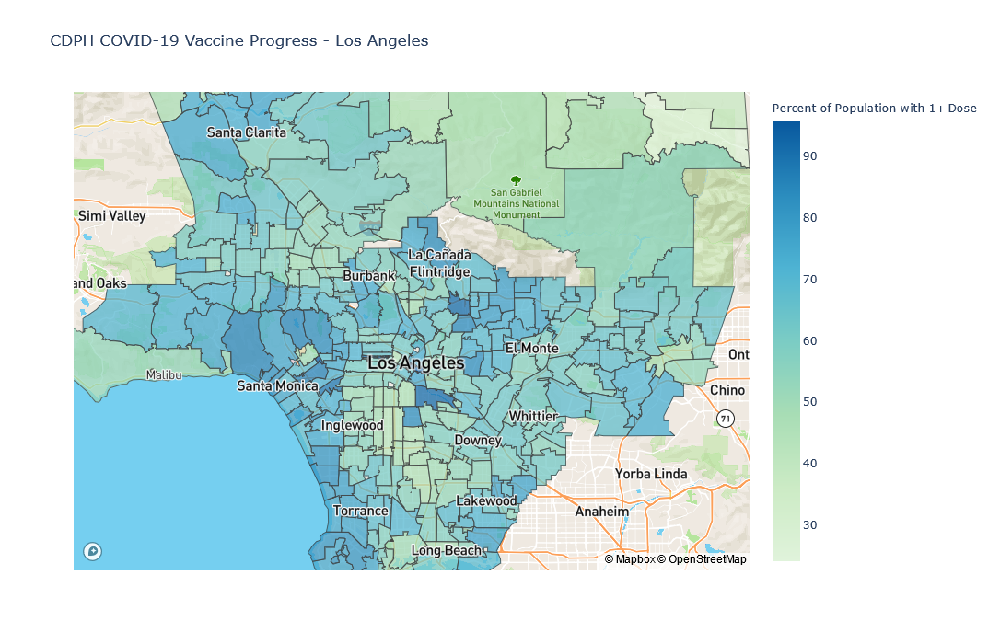

In [7]:
fig = vax_choropleth(one_dose, 'Los Angeles', *map_scope['Los Angeles'])
fig.show()

In [8]:
for area in 'SoCal', 'Bay Area':
    for metric in metrics.keys():
        fig = vax_choropleth(metric, area, *map_scope[area])
        fig.write_html(
            f"html/ca_vaccine_zcta_{area.lower().replace(' ', '')}_{metrics[metric]}.html",
            include_plotlyjs='cdn'
        )

In [9]:
# px.colors.sequential.swatches_continuous().show()